# Завантажте та ознайомтесь з даними
## Завантажте набір даних Breast Cancer та створіть DataFrame
Перегляд характеристик

In [134]:
from sklearn.datasets import load_breast_cancer
import pandas as pd

# Завантаження набору
bc = load_breast_cancer()

# Якщо доступний уже готовий DataFrame (нові версії sklearn)
if hasattr(bc, "frame") and isinstance(bc.frame, pd.DataFrame):
    breast_cancer_df = bc.frame.copy()
else:
    # Ручне складання DataFrame з 2D масиву ознак
    feature_names = list(bc["feature_names"]) if "feature_names" in bc else None
    X = pd.DataFrame(bc["data"], columns=feature_names)
    y = pd.Series(bc["target"], name="target")
    breast_cancer_df = pd.concat([X, y], axis=1)
    # Додаємо зрозумілу назву класу, якщо є target_names
    if "target_names" in bc:
        mapping = {i: name for i, name in enumerate(bc["target_names"])}
        breast_cancer_df["target_name"] = breast_cancer_df["target"].map(mapping)

# Перевірка структури
breast_cancer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

In [135]:
breast_cancer_df.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,0.627417
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,0.483918
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,0.000000
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,1.000000
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,1.000000
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,1.000000


In [136]:
breast_cancer_df.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target,target_name
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0,malignant
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0,malignant
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0,malignant
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0,malignant
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0,malignant


# Стандартизуйте дані

In [137]:
breast_cancer_df[breast_cancer_df['target'] != 0].head()
def standardize_columns(df):
    df = df.copy()
    df.columns = df.columns.map(str)
    return df

# Використання
breast_cancer_df = standardize_columns(breast_cancer_df)

In [138]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler

one_hot_encoder = OneHotEncoder()
scale_encoder = StandardScaler()

columns = breast_cancer_df.columns.map(str)
num_columns = [c for c in columns if c != "target_name"]
cat_columns = ["target_name"]

preprocessor = ColumnTransformer(
    transformers=[
        ("num", StandardScaler(), list(map(str, num_columns))),        # числові → StandardScaler
        ("cat", OneHotEncoder(
            sparse_output=False,      # було True за замовчуванням — змінюємо на False
            handle_unknown="ignore"   # додатково рекомендується
         ),
         list(map(str, cat_columns)))          # категоріальні → OneHot
    ],
    remainder="passthrough"  # решту (id) пропускаємо як є
)

# Pipeline тільки з препроцесором
pipe = Pipeline(steps=[
    ("preprocess", preprocessor)
])

pipe.set_output(transform="pandas")

# Трансформуємо дані
df_transformed = pipe.fit_transform(breast_cancer_df)

df_transformed.head()

,num__mean radius,num__mean texture,num__mean perimeter,num__mean area,num__mean smoothness,num__mean compactness,num__mean concavity,num__mean concave points,num__mean symmetry,num__mean fractal dimension,...,num__worst area,num__worst smoothness,num__worst compactness,num__worst concavity,num__worst concave points,num__worst symmetry,num__worst fractal dimension,num__target,cat__target_name_benign,cat__target_name_malignant
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015,-1.297676,0.0,1.0
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190,-1.297676,0.0,1.0
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391,-1.297676,0.0,1.0
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010,-1.297676,0.0,1.0
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100,-1.297676,0.0,1.0


# Побудуйте точкові діаграми
Розподіл даних базуємо на категоріальних колонках з стандартизованих даних: _cat__target_name_malignant_, _cat__target_name_benign_

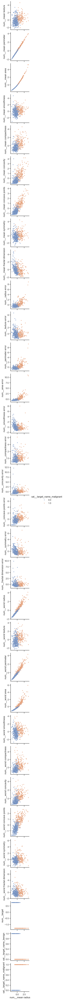

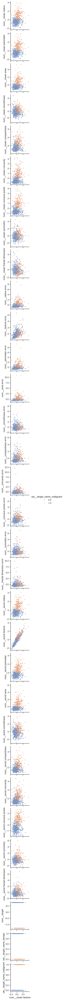

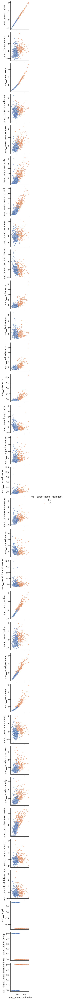

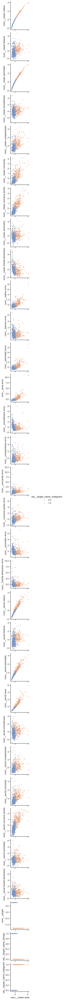

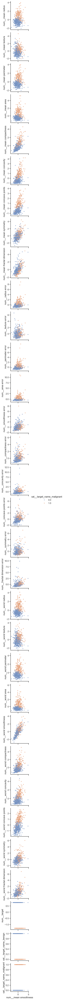

...

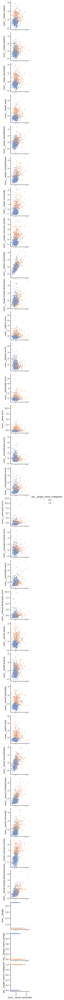

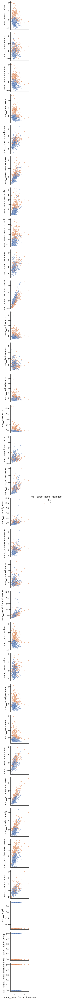

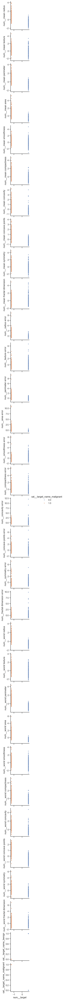

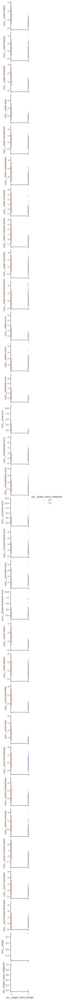

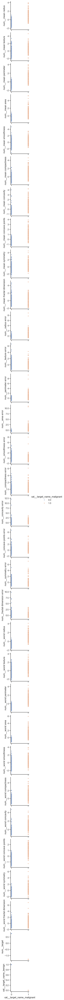

In [139]:
from matplotlib import pyplot as plt
import seaborn as sns

sns.set(style="ticks", context="notebook")

num_cols = df_transformed.select_dtypes(include="number").columns

for ref_col in df_transformed.columns:
    sns.pairplot(
    data=df_transformed,
    x_vars=[ref_col],
    y_vars=[c for c in num_cols if c != ref_col],
    hue="cat__target_name_malignant" if "cat__target_name_malignant" in df_transformed.columns else None,
    height=2.2,
    aspect=1.0,
    plot_kws={"alpha": 0.6, "s": 15}
    )

    plt.show()




# Обчисліть матриці відстаней

In [140]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.metrics import pairwise_distances

def draw_heatmap(
    D,
    title: str = "",
    labels=None,
    mask_upper: bool = True,
    cluster: bool = True,
    figsize=None,
    cmap: str = "mako",
    vmin: float | None = None,
    vmax: float | None = None,
    annotate: bool = False,
):
    """
    Зручна візуалізація матриці відстаней.

    Параметри:
    - D: np.ndarray | pd.DataFrame — квадратна матриця відстаней (n x n)
    - title: заголовок
    - labels: список/масив довжини n для підписів осей (опційно)
    - mask_upper: якщо True — приховати верхній трикутник
    - cluster: якщо True — показати кластеризовану теплокарту (sns.clustermap)
    - figsize: розмір фігури; якщо None — підбирається від n
    - cmap: палітра
    - vmin, vmax: межі шкали кольорів; якщо None — ставляться за робастними квантилями
    - annotate: показувати числа в клітинках (рекомендується лише для малих n)
    """

    A = np.asarray(D)
    if A.ndim != 2 or A.shape[0] != A.shape[1]:
        raise ValueError(f"Очікується квадратна матриця (n x n), отримано shape={A.shape}")
    n = A.shape[0]

    # Підготовка підписів
    if labels is not None and len(labels) == n:
        idx = list(map(str, labels))
    else:
        idx = [str(i) for i in range(n)]

    df = pd.DataFrame(A, index=idx, columns=idx)

    # Робастні межі кольорів, якщо не задано
    if vmin is None:
        vmin = float(np.quantile(A, 0.01))
    if vmax is None:
        vmax = float(np.quantile(A, 0.99))
    if vmin >= vmax:
        vmin, vmax = float(np.min(A)), float(np.max(A))

    # Автоматичний розмір
    if figsize is None:
        # Трохи збільшуємо з n, але обмежуємо верхню межу
        base = 6.0
        k = min(14.0, base + 0.02 * n)
        figsize = (k, k)

    sns.set(style="ticks", context="notebook")

    if cluster:
        # Кластеризована теплокарта (без маски)
        g = sns.clustermap(
            df,
            cmap=cmap,
            figsize=figsize,
            vmin=vmin,
            vmax=vmax,
            xticklabels=False if n > 60 else True,
            yticklabels=False if n > 60 else True,
            cbar_kws={"label": "distance"},
        )
        g.ax_heatmap.set_title(title)
        plt.show()
        return g

    # Звичайна теплокарта з маскою верхнього трикутника (за замовчуванням)
    mask = None
    if mask_upper:
        mask = np.triu(np.ones_like(df, dtype=bool), k=1)

    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(
        df,
        titles=title,
        ax=ax,
        cmap=cmap,
        vmin=vmin,
        vmax=vmax,
        mask=mask,
        square=True,
        linewidths=0,
        linecolor="none",
        cbar_kws={"label": "distance"},
        xticklabels=False if n > 60 else True,
        yticklabels=False if n > 60 else True,
        fmt=".2f",
    )
    ax.set_title(title)
    plt.tight_layout()
    plt.show()
    return ax

D_euclidean = pairwise_distances(df_transformed, metric="euclidean")
D_manhattan = pairwise_distances(df_transformed, metric="manhattan")   # те саме, що "cityblock" або "l1"
D_cityblock = pairwise_distances(df_transformed, metric="cityblock")
D_l1 = pairwise_distances(df_transformed, metric="l1")
D_cosine = pairwise_distances(df_transformed, metric="cosine")


# Візуалізуйте отримані матриці

/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  

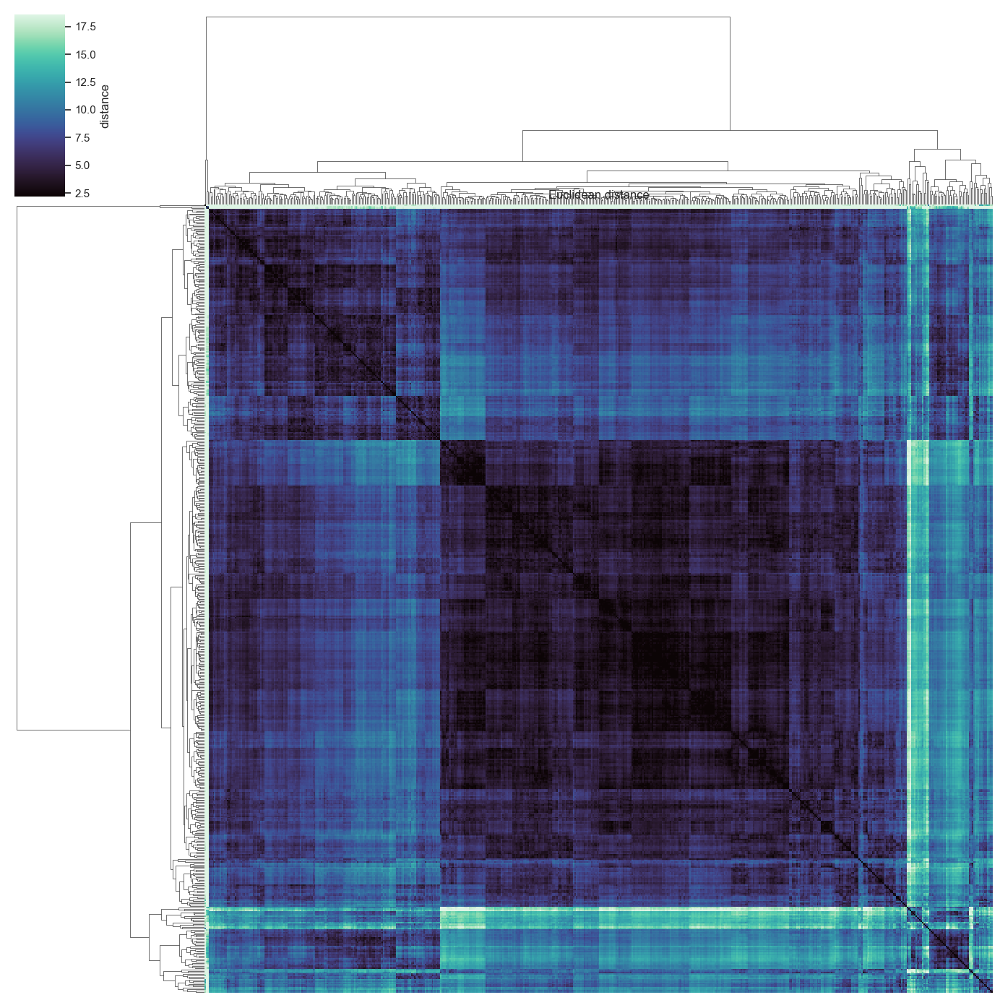

In [141]:
draw_heatmap(D_euclidean, "Euclidean distance", cluster=True)

/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  

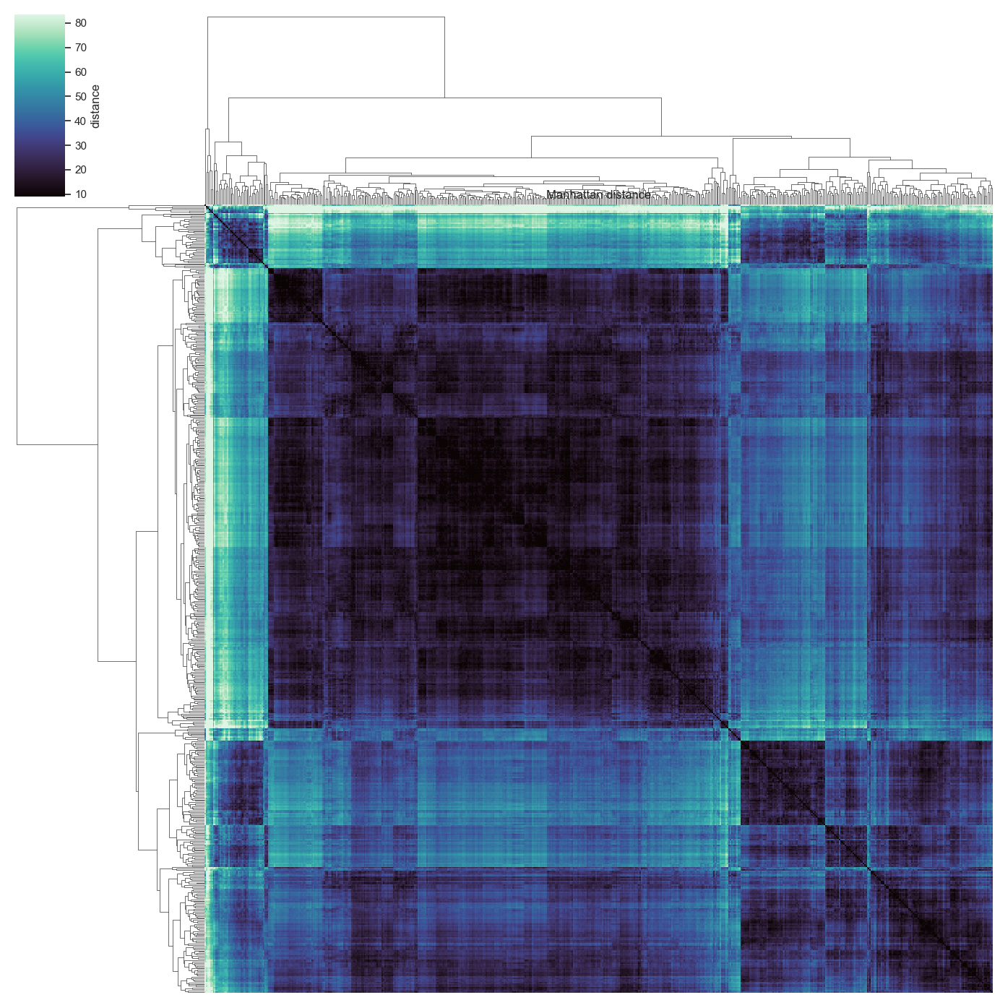

In [142]:
draw_heatmap(D_manhattan, "Manhattan distance", cluster=True)

/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  

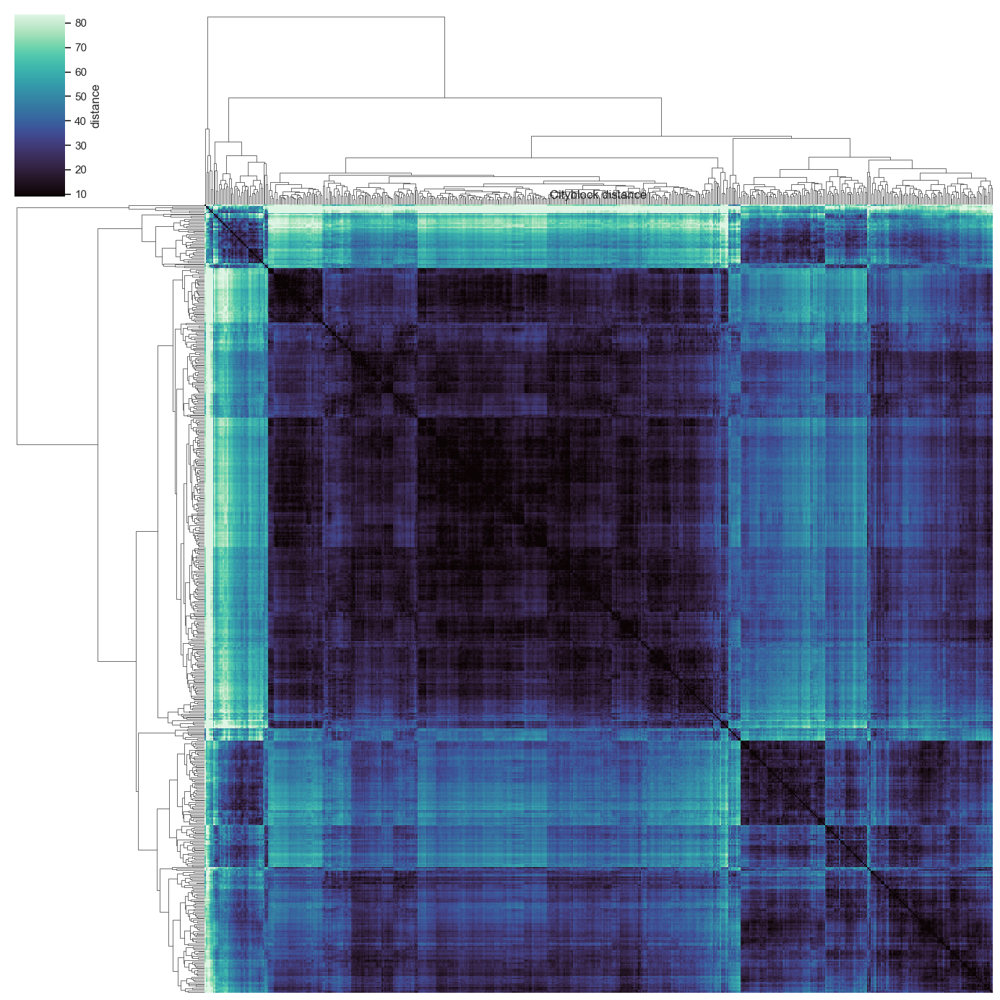

In [143]:
draw_heatmap(D_cityblock, "Cityblock distance", cluster=True)

/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  

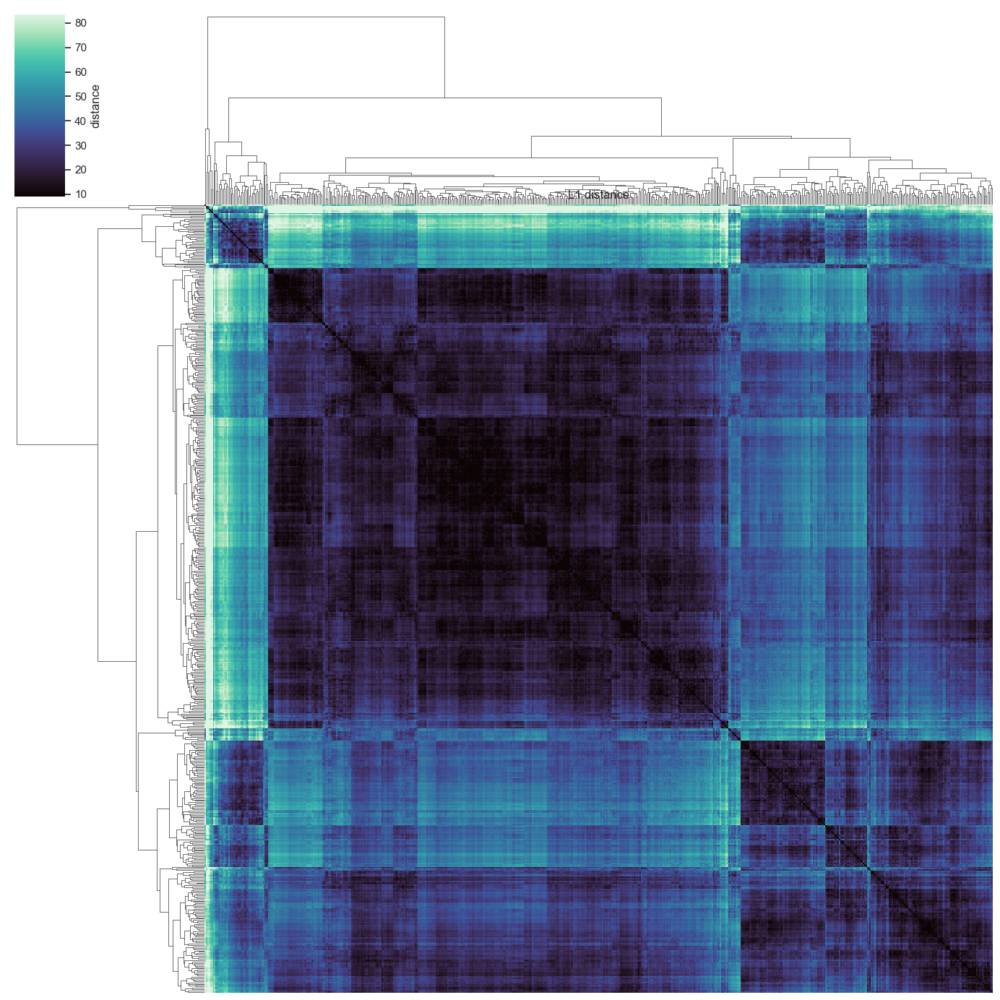

In [144]:
draw_heatmap(D_l1, "L1 distance", cluster=True)

/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/kozak_mamay/PycharmProjects/WoolfDataScience/.venv/lib/python3.12/site-packages/seaborn/matrix.py:530: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  

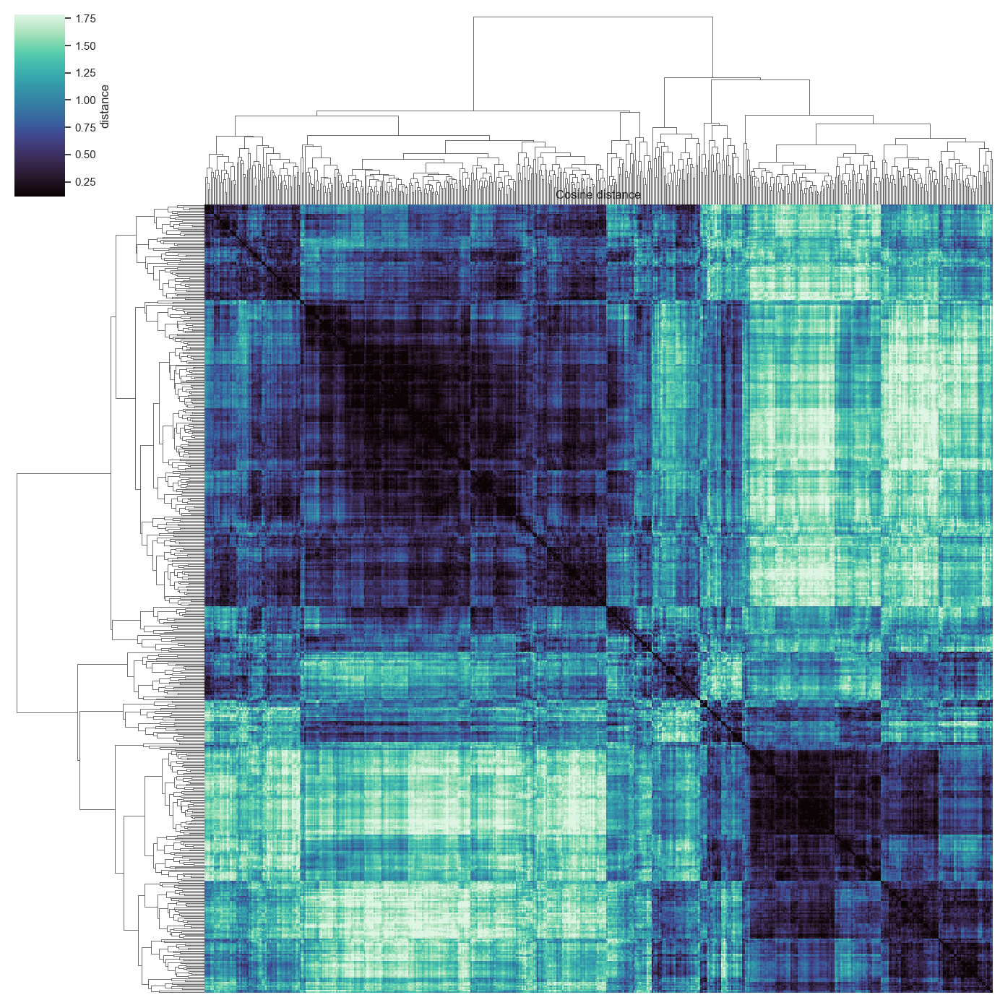

In [145]:
draw_heatmap(D_cosine, "Cosine distance", cluster=True)

# Висновки

Для більш якісного аналізу даних їх було стандартизовано за допомогою **StandartScaler()** (щоб згладити розкид даних) та **OneHotEncoder()**, аби привести категоріальні дані до числового формату та розділити на колонки-категорії, за яким легше потім кластеризувати дані. Отже, у візуалізації розподілу даних маємо такі кластери:
- cat__target_name_benign
- cat__target_name_malignant

Як бачимо з візуалізацій, незавжаючи на попередню обробку, дані мають часто великі викиди. Отже, для більш ретельного аналізу треба застосовувати більш ретельну обробку. Водночас, дані по кластерах знаходяться більш чи менш сепаратно, що дає можливість чітко їх класифікувати. Змішання даних у різних кластерах характерне лише для колонок, що представляють помилки чи відхилення (як от _radius error_ тощо).

Було також проведено обчислення матриць відстаней засобами **sklearn** наступними методами:
- Euclidean distance
- Manhattan distance
- Cityblock distance
- L1 distance
- Cosine distance

З візуалізацій цих матриць найбільш відпоідною мені видається _Cosine distance_, позаяк:
- Чітко відображає збільшення відстаней від діагоналі (що репрезентує відстань колонки до самої себе)
- Найчіткіше відображає відстань однієї категорії від іншої.
